In [46]:
import os
import matplotlib.pyplot as plt
import numpy as np
import librosa
import IPython.display as ipd
from scipy import signal
from scipy.fft import fft, fftfreq
import io
import urllib.request
from scipy.io import wavfile

from IPython.display import Audio, display

## Loading Audio Files

In [47]:
def load_audio_from_url(url):
    """Load audio directly from URL without saving to disk"""
    try:
        print(f"Streaming audio from URL...")
        # Download to memory
        with urllib.request.urlopen(url) as response:
            audio_data = response.read()
        
        # Create a file-like object in memory
        audio_file = io.BytesIO(audio_data)
        
        # Read WAV file from memory
        sample_rate, audio_array = wavfile.read(audio_file)
        
        # Convert to mono if stereo
        if len(audio_array.shape) > 1:
            audio_array = audio_array.mean(axis=1)
        
        # Normalize
        audio_array = audio_array.astype(float)
        if np.max(np.abs(audio_array)) > 0:
            audio_array = audio_array / np.max(np.abs(audio_array))
        
        print(f"✓ Loaded audio: {len(audio_array)} samples at {sample_rate} Hz")
        return audio_array, sample_rate
        
    except Exception as e:
        print(f"✗ Failed to load audio: {e}")
        return None, None

# Try to load audio from online source
print("="*70)
print("AUDIO LOADING (NO FILES SAVED)")
print("="*70)

# Try multiple sources
audio_urls = [
    'https://www.kozco.com/tech/organfinale.wav',
    'https://www.kozco.com/tech/piano2.wav',
    'https://freewavesamples.com/files/Alesis-Sanctuary-QCard-Crickets.wav'
]

# Collect multiple audio files
audio_files = []  # List to store (audio_data, sample_rate, url) tuples

for url in audio_urls:
    audio_data, sample_rate = load_audio_from_url(url)
    if audio_data is not None:
        audio_files.append({
            'data': audio_data,
            'sample_rate': sample_rate,
            'url': url,
            'name': url.split('/')[-1]  # Extract filename from URL
        })
        print(f"✓ Added to collection: {url.split('/')[-1]}")

print(f"\n{'='*70}")
print(f"Successfully loaded {len(audio_files)} audio file(s)")
print(f"{'='*70}")

AUDIO LOADING (NO FILES SAVED)
Streaming audio from URL...


/tmp/ipython-input-1564709216.py:13: WavFileWarning: Chunk (non-data) not understood, skipping it.
  sample_rate, audio_array = wavfile.read(audio_file)


✓ Loaded audio: 573378 samples at 44100 Hz
✓ Added to collection: organfinale.wav
Streaming audio from URL...
✓ Loaded audio: 302712 samples at 48000 Hz
✓ Added to collection: piano2.wav
Streaming audio from URL...
✓ Loaded audio: 405562 samples at 44100 Hz
✓ Added to collection: Alesis-Sanctuary-QCard-Crickets.wav

Successfully loaded 3 audio file(s)


In [48]:
display(Audio(audio_files[0]['data'], rate=audio_files[0]['sample_rate']))

In [49]:
display(Audio(audio_files[1]['data'], rate=audio_files[1]['sample_rate']))

In [50]:
display(Audio(audio_files[2]['data'], rate=audio_files[2]['sample_rate']))

In [51]:
# load audio files with librosa
debussy, sr = audio_files[0]['data'], audio_files[0]['sample_rate']
redhot, _ = audio_files[1]['data'], audio_files[1]['sample_rate']
duke, _ = audio_files[2]['data'], audio_files[2]['sample_rate']

## Root-mean-squared energy with Librosa

In [52]:
FRAME_SIZE = 1024
HOP_LENGTH = 512

In [53]:
rms_debussy = librosa.feature.rms(y=debussy, frame_length=FRAME_SIZE, hop_length=HOP_LENGTH)[0]
rms_redhot = librosa.feature.rms(y=redhot, frame_length=FRAME_SIZE, hop_length=HOP_LENGTH)[0]
rms_duke = librosa.feature.rms(y=duke, frame_length=FRAME_SIZE, hop_length=HOP_LENGTH)[0]

## Visualise RMSE + waveform

In [54]:
frames = range(len(rms_debussy))
t = librosa.frames_to_time(frames, hop_length=HOP_LENGTH)

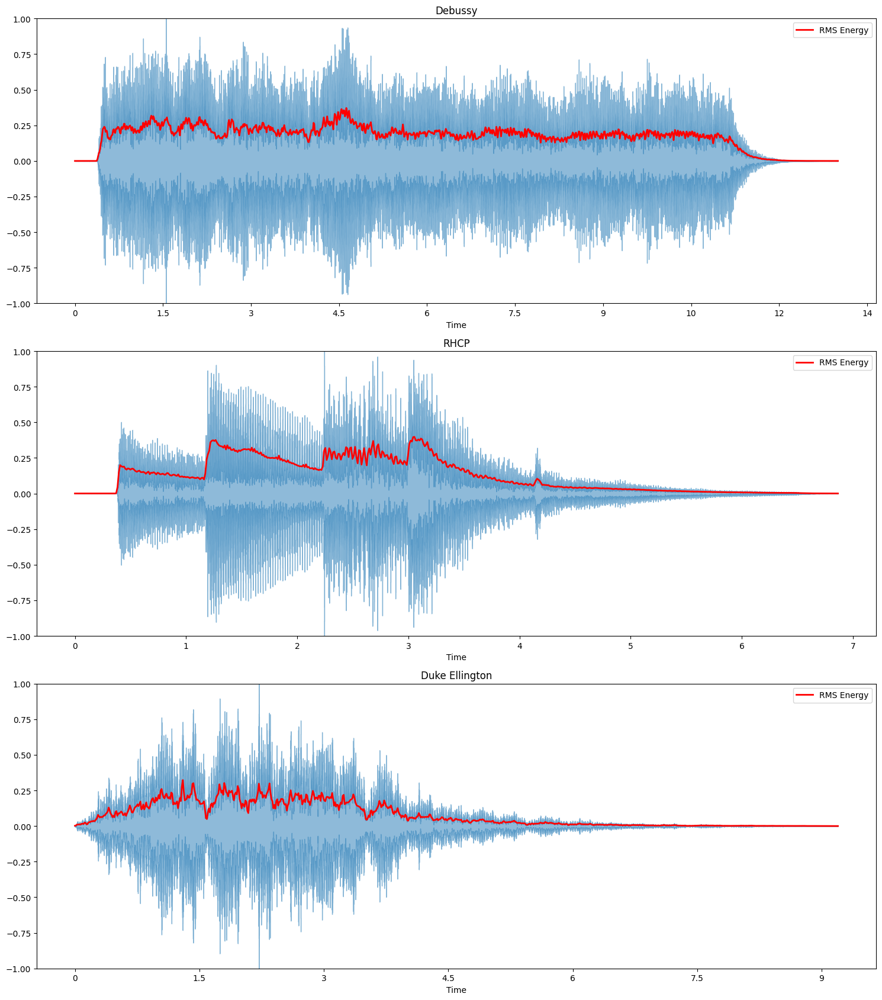

In [55]:
# rms energy is graphed in red

plt.figure(figsize=(15, 17))

# Create separate time arrays for each audio file
t_debussy = np.linspace(0, len(debussy) / sr, len(rms_debussy))
t_redhot = np.linspace(0, len(redhot) / sr, len(rms_redhot))
t_duke = np.linspace(0, len(duke) / sr, len(rms_duke))

ax = plt.subplot(3, 1, 1)
librosa.display.waveshow(debussy, sr=sr, alpha=0.5)
plt.plot(t_debussy, rms_debussy, color="r", linewidth=2, label="RMS Energy")
plt.ylim((-1, 1))
plt.title("Debussy")
plt.legend()

plt.subplot(3, 1, 2)
librosa.display.waveshow(redhot, sr=sr, alpha=0.5)
plt.plot(t_redhot, rms_redhot, color="r", linewidth=2, label="RMS Energy")
plt.ylim((-1, 1))
plt.title("RHCP")
plt.legend()

plt.subplot(3, 1, 3)
librosa.display.waveshow(duke, sr=sr, alpha=0.5)
plt.plot(t_duke, rms_duke, color="r", linewidth=2, label="RMS Energy")
plt.ylim((-1, 1))
plt.title("Duke Ellington")
plt.legend()

plt.tight_layout()
plt.show()

## RMSE from scratch

In [56]:
def rmse(signal, frame_size, hop_length):
    rmse = []
    
    # calculate rmse for each frame
    for i in range(0, len(signal), hop_length): 
        rmse_current_frame = np.sqrt(sum(signal[i:i+frame_size]**2) / frame_size)
        rmse.append(rmse_current_frame)
    return np.array(rmse)    

In [57]:
rms_debussy1 = rmse(debussy, FRAME_SIZE, HOP_LENGTH)
rms_redhot1 = rmse(redhot, FRAME_SIZE, HOP_LENGTH)
rms_duke1 = rmse(duke, FRAME_SIZE, HOP_LENGTH)

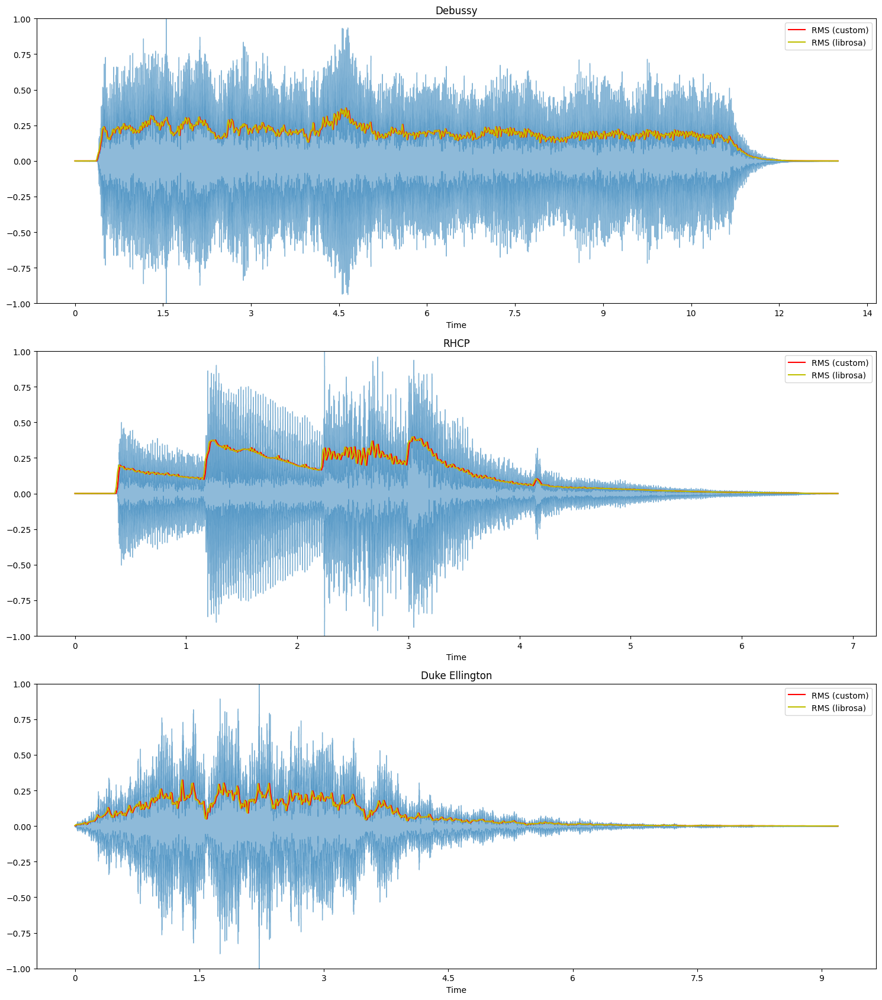

In [58]:
plt.figure(figsize=(15, 17))

# Create separate time arrays for each audio file
t_debussy = np.linspace(0, len(debussy) / sr, len(rms_debussy))
t_redhot = np.linspace(0, len(redhot) / sr, len(rms_redhot))
t_duke = np.linspace(0, len(duke) / sr, len(rms_duke))

ax = plt.subplot(3, 1, 1)
librosa.display.waveshow(debussy, sr=sr, alpha=0.5)
plt.plot(t_debussy, rms_debussy, color="r", label="RMS (custom)")
plt.plot(t_debussy, rms_debussy1, color="y", label="RMS (librosa)")
plt.ylim((-1, 1))
plt.title("Debussy")
plt.legend()

plt.subplot(3, 1, 2)
librosa.display.waveshow(redhot, sr=sr, alpha=0.5)
plt.plot(t_redhot, rms_redhot, color="r", label="RMS (custom)")
plt.plot(t_redhot, rms_redhot1, color="y", label="RMS (librosa)")
plt.ylim((-1, 1))
plt.title("RHCP")
plt.legend()

plt.subplot(3, 1, 3)
librosa.display.waveshow(duke, sr=sr, alpha=0.5)
plt.plot(t_duke, rms_duke, color="r", label="RMS (custom)")
plt.plot(t_duke, rms_duke1, color="y", label="RMS (librosa)")
plt.ylim((-1, 1))
plt.title("Duke Ellington")
plt.legend()

plt.tight_layout()
plt.show()

## Zero-crossing rate with Librosa

In [59]:
zcr_debussy = librosa.feature.zero_crossing_rate(debussy, frame_length=FRAME_SIZE, hop_length=HOP_LENGTH)[0]
zcr_redhot = librosa.feature.zero_crossing_rate(redhot, frame_length=FRAME_SIZE, hop_length=HOP_LENGTH)[0]
zcr_duke = librosa.feature.zero_crossing_rate(duke, frame_length=FRAME_SIZE, hop_length=HOP_LENGTH)[0]

In [60]:
zcr_debussy.size

1120

## Visualise zero-crossing rate with Librosa

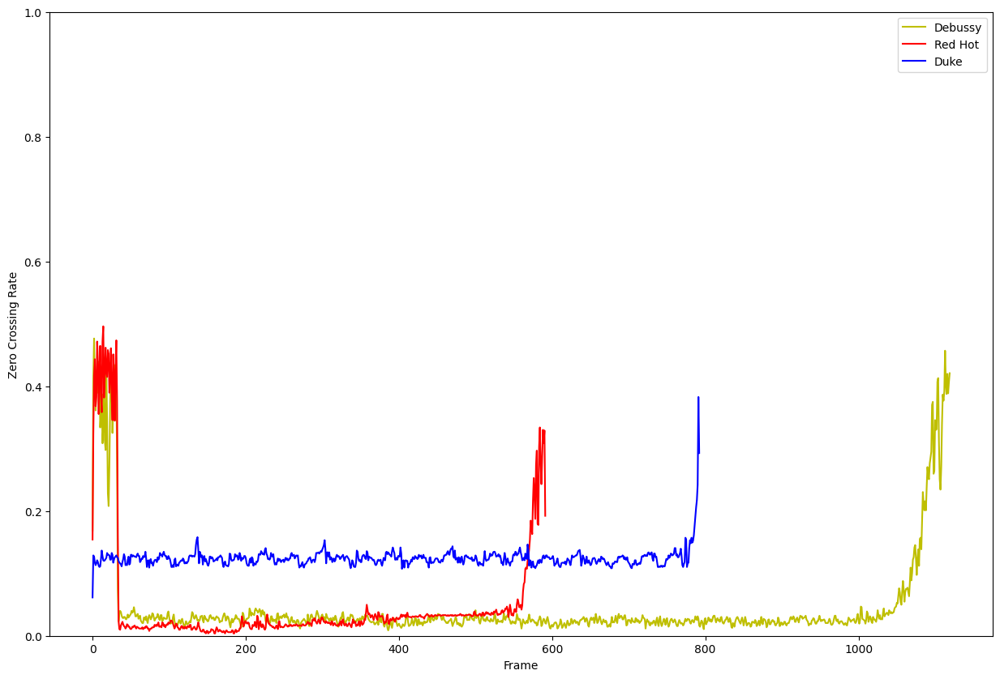

In [64]:
plt.figure(figsize=(15, 10))

# Create time arrays for each signal based on their actual lengths
t_debussy = np.arange(len(zcr_debussy))
t_redhot = np.arange(len(zcr_redhot))
t_duke = np.arange(len(zcr_duke))

plt.plot(t_debussy, zcr_debussy, color="y", label="Debussy")
plt.plot(t_redhot, zcr_redhot, color="r", label="Red Hot")
plt.plot(t_duke, zcr_duke, color="b", label="Duke")
plt.ylim(0, 1)
plt.xlabel("Frame")
plt.ylabel("Zero Crossing Rate")
plt.legend()
plt.show()

## ZCR: Voice vs Noise

In [82]:
# Try multiple sources
audio_urls = [
        'https://www.kozco.com/tech/audacity/CarTalk-KPCC-852.wav',
        'https://www.kozco.com/tech/audacity/1a.wav'
]

# Collect multiple audio files
voice_noise_files = []  # List to store (audio_data, sample_rate, url) tuples

for url in audio_urls:
    audio_data, sample_rate = load_audio_from_url(url)
    if audio_data is not None:
        voice_noise_files.append({
            'data': audio_data,
            'sample_rate': sample_rate,
            'url': url,
            'name': url.split('/')[-1]  # Extract filename from URL
        })
        print(f"✓ Added to collection: {url.split('/')[-1]}")

print(f"\n{'='*70}")
print(f"Successfully loaded {len(voice_noise_files)} audio file(s)")
print(f"{'='*70}")

Streaming audio from URL...
✓ Loaded audio: 2755531 samples at 44100 Hz
✓ Added to collection: CarTalk-KPCC-852.wav
Streaming audio from URL...
✓ Loaded audio: 1332578 samples at 44100 Hz
✓ Added to collection: 1a.wav

Successfully loaded 2 audio file(s)


In [83]:
display(Audio(voice_noise_files[0]['data'], rate=voice_noise_files[0]['sample_rate']))

In [84]:
display(Audio(voice_noise_files[1]['data'], rate=voice_noise_files[1]['sample_rate']))

In [85]:
# load audio files with librosa
voice, sr = voice_noise_files[0]['data'], voice_noise_files[0]['sample_rate']
noise, _ = voice_noise_files[1]['data'], voice_noise_files[1]['sample_rate']

# get ZCR
zcr_voice = librosa.feature.zero_crossing_rate(voice, frame_length=FRAME_SIZE, hop_length=HOP_LENGTH)[0]
zcr_noise = librosa.feature.zero_crossing_rate(noise, frame_length=FRAME_SIZE, hop_length=HOP_LENGTH)[0]

In [86]:
frames = range(len(zcr_voice))
t = librosa.frames_to_time(frames, hop_length=HOP_LENGTH)

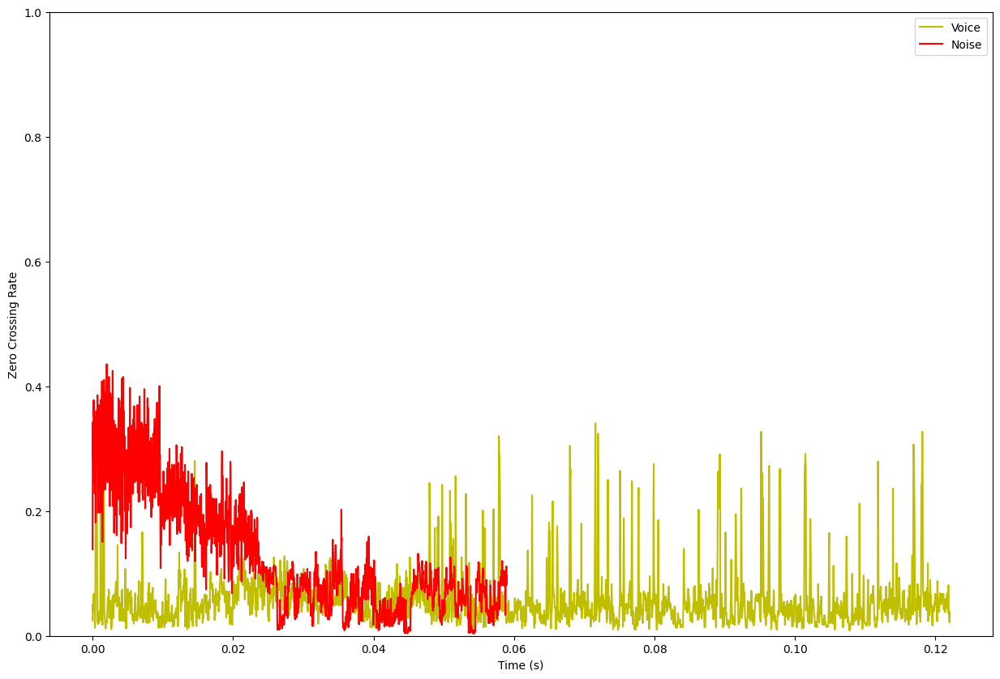

In [89]:
plt.figure(figsize=(15, 10))

# Create separate time arrays for each signal
t_voice = np.arange(len(zcr_voice)) / sr
t_noise = np.arange(len(zcr_noise)) / sr

plt.plot(t_voice, zcr_voice, color="y", label="Voice")
plt.plot(t_noise, zcr_noise, color="r", label="Noise")
plt.ylim(0, 1)
plt.xlabel("Time (s)")
plt.ylabel("Zero Crossing Rate")
plt.legend()
plt.show()

/tmp/ipython-input-3986325782.py:30: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


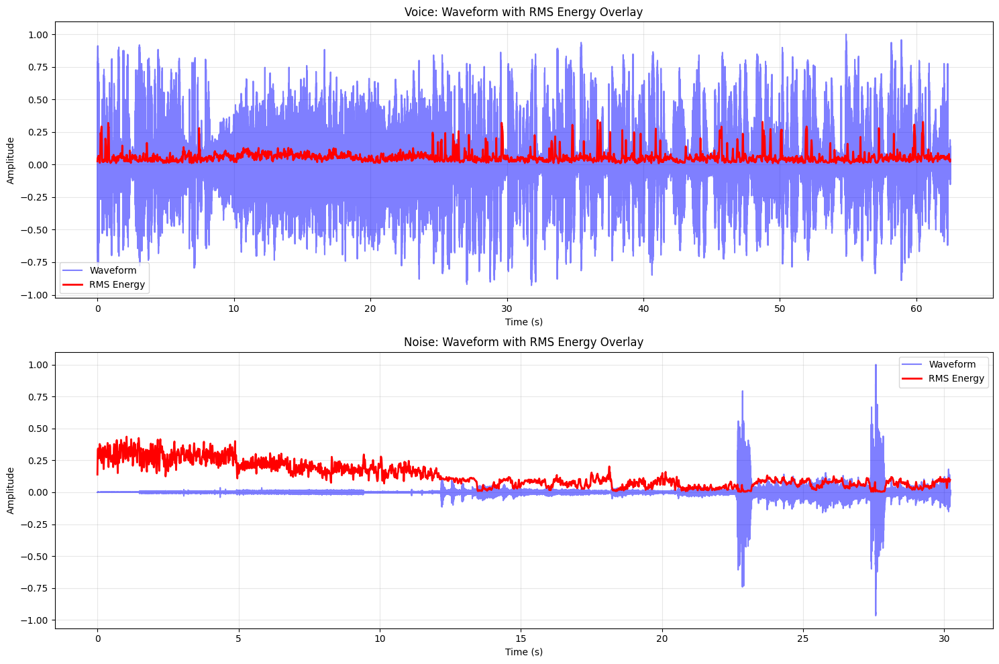

In [92]:
plt.figure(figsize=(15, 10))

# Create time arrays
t_signal = np.arange(len(voice)) / sr
t_rms = librosa.frames_to_time(np.arange(len(zcr_voice)), sr=sr)

# Plot waveform
plt.subplot(2, 1, 1)
plt.plot(t_signal, voice, color='b', alpha=0.5, label='Waveform')
plt.plot(t_rms, zcr_voice, color='r', linewidth=2, label='RMS Energy')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('Voice: Waveform with RMS Energy Overlay')
plt.legend()
plt.grid(True, alpha=0.3)

# Plot for noise
plt.subplot(2, 1, 2)
t_signal_noise = np.arange(len(noise)) / sr
t_rms_noise = librosa.frames_to_time(np.arange(len(zcr_noise)), sr=sr)

plt.plot(t_signal_noise, noise, color='b', alpha=0.5, label='Waveform')
plt.plot(t_rms_noise, zcr_noise, color='r', linewidth=2, label='RMS Energy')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('Noise: Waveform with RMS Energy Overlay')
plt.legend()
plt.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

/tmp/ipython-input-1608318186.py:45: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.tight_layout(rect=[0, 0.05, 1, 1])


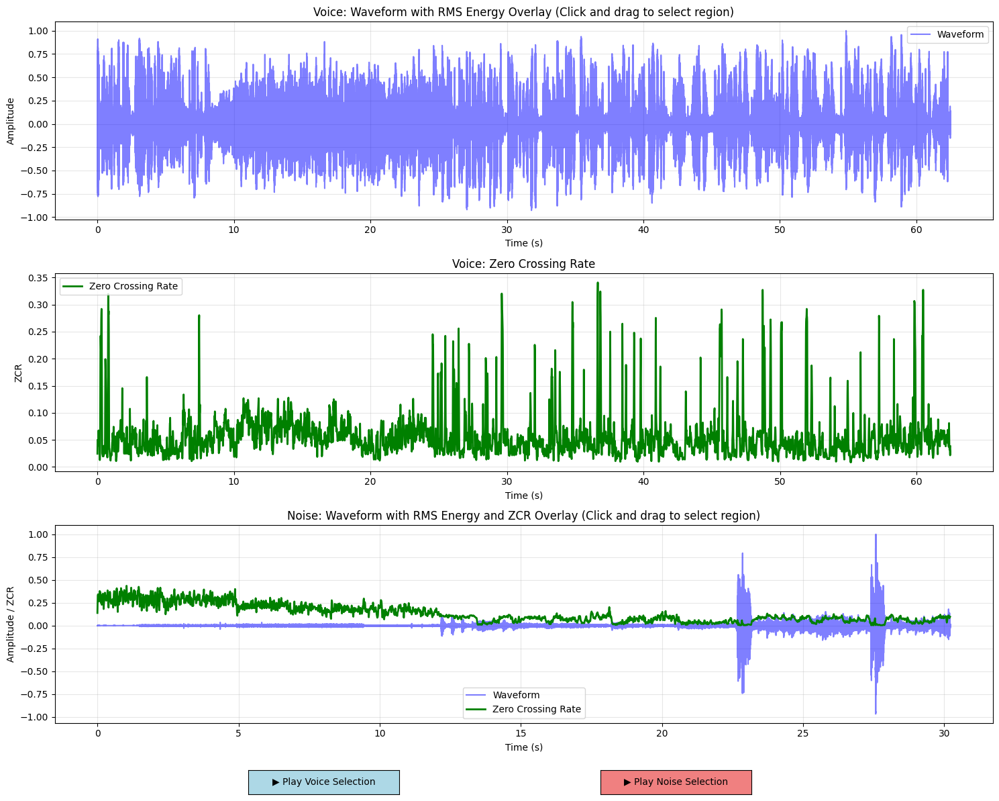


🎵 Full Audio Players:
Voice:



Noise:


In [95]:
from matplotlib.widgets import Button, SpanSelector
import matplotlib.pyplot as plt

# Create figure with extra space for buttons
fig = plt.figure(figsize=(15, 12))

# Create time arrays
t_signal = np.arange(len(voice)) / sr
t_zcr = librosa.frames_to_time(np.arange(len(zcr_voice)), sr=sr)

# Store selected regions
selected_region = {'voice': None, 'noise': None}

# Plot waveform with RMS Energy
ax1 = plt.subplot(3, 1, 1)
plt.plot(t_signal, voice, color='b', alpha=0.5, label='Waveform')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('Voice: Waveform with RMS Energy Overlay (Click and drag to select region)')
plt.legend()
plt.grid(True, alpha=0.3)

# Plot Zero Crossing Rate
ax2 = plt.subplot(3, 1, 2)
plt.plot(t_zcr, zcr_voice, color='g', linewidth=2, label='Zero Crossing Rate')
plt.xlabel('Time (s)')
plt.ylabel('ZCR')
plt.title('Voice: Zero Crossing Rate')
plt.legend()
plt.grid(True, alpha=0.3)

# Plot for noise
ax3 = plt.subplot(3, 1, 3)
t_signal_noise = np.arange(len(noise)) / sr
t_zcr_noise = librosa.frames_to_time(np.arange(len(zcr_noise)), sr=sr)

plt.plot(t_signal_noise, noise, color='b', alpha=0.5, label='Waveform')
plt.plot(t_zcr_noise, zcr_noise, color='g', linewidth=2, label='Zero Crossing Rate')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude / ZCR')
plt.title('Noise: Waveform with RMS Energy and ZCR Overlay (Click and drag to select region)')
plt.legend()
plt.grid(True, alpha=0.3)

plt.tight_layout(rect=[0, 0.05, 1, 1])

# Callback functions for region selection
def onselect_voice(xmin, xmax):
    selected_region['voice'] = (xmin, xmax)
    print(f"Voice region selected: {xmin:.2f}s - {xmax:.2f}s")

def onselect_noise(xmin, xmax):
    selected_region['noise'] = (xmin, xmax)
    print(f"Noise region selected: {xmin:.2f}s - {xmax:.2f}s")

# Add SpanSelector for interactive region selection
span_voice = SpanSelector(
    ax1, onselect_voice, 'horizontal',
    useblit=True,
    props=dict(alpha=0.3, facecolor='yellow'),
    interactive=True,
    drag_from_anywhere=True
)

span_noise = SpanSelector(
    ax3, onselect_noise, 'horizontal',
    useblit=True,
    props=dict(alpha=0.3, facecolor='yellow'),
    interactive=True,
    drag_from_anywhere=True
)

# Add play buttons
ax_play_voice = plt.axes([0.25, 0.01, 0.15, 0.03])
ax_play_noise = plt.axes([0.60, 0.01, 0.15, 0.03])

btn_voice = Button(ax_play_voice, '▶ Play Voice Selection', color='lightblue', hovercolor='skyblue')
btn_noise = Button(ax_play_noise, '▶ Play Noise Selection', color='lightcoral', hovercolor='salmon')

def play_voice(event):
    if selected_region['voice'] is not None:
        xmin, xmax = selected_region['voice']
        start_sample = int(xmin * sr)
        end_sample = int(xmax * sr)
        audio_segment = voice[start_sample:end_sample]
        print(f"Playing voice from {xmin:.2f}s to {xmax:.2f}s")
        display(Audio(audio_segment, rate=sr, autoplay=True))
    else:
        print("Playing full voice audio")
        display(Audio(voice, rate=sr, autoplay=True))

def play_noise(event):
    if selected_region['noise'] is not None:
        xmin, xmax = selected_region['noise']
        start_sample = int(xmin * sr)
        end_sample = int(xmax * sr)
        audio_segment = noise[start_sample:end_sample]
        print(f"Playing noise from {xmin:.2f}s to {xmax:.2f}s")
        display(Audio(audio_segment, rate=sr, autoplay=True))
    else:
        print("Playing full noise audio")
        display(Audio(noise, rate=sr, autoplay=True))

btn_voice.on_clicked(play_voice)
btn_noise.on_clicked(play_noise)

plt.show()

# Also display full audio players below the plot
print("\n🎵 Full Audio Players:")
print("Voice:")
display(Audio(voice, rate=sr))
print("\nNoise:")
display(Audio(noise, rate=sr))